<a href="https://colab.research.google.com/github/olorunfemibabalola/Computer-Vision-Learning/blob/main/03_OpenCV_image_feature_descriptors_2026.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [ ]:
!gdown https://drive.google.com/uc?id=18iSMK5cmBA5V8zc18-jIB2Vel6pnVHBI -O "04-files.zip"
!unzip -o 04-files.zip

Downloading...
From: https://drive.google.com/uc?id=18iSMK5cmBA5V8zc18-jIB2Vel6pnVHBI
To: /content/04-files.zip
100% 15.8M/15.8M [00:00<00:00, 102MB/s]
Archive:  04-files.zip
   creating: 04-files/
  inflating: __MACOSX/._04-files     
  inflating: 04-files/cars.jpg       
  inflating: __MACOSX/04-files/._cars.jpg  
  inflating: 04-files/IMG_5781.JPG   
  inflating: __MACOSX/04-files/._IMG_5781.JPG  
  inflating: 04-files/IMG_5782.JPG   
  inflating: __MACOSX/04-files/._IMG_5782.JPG  
  inflating: 04-files/IMG_5783.JPG   
  inflating: __MACOSX/04-files/._IMG_5783.JPG  
  inflating: 04-files/.DS_Store      
  inflating: __MACOSX/04-files/._.DS_Store  
  inflating: 04-files/fusion-building.jpg  
  inflating: __MACOSX/04-files/._fusion-building.jpg  
  inflating: 04-files/cars2.jpg      
  inflating: __MACOSX/04-files/._cars2.jpg  
  inflating: 04-files/chessboard.jpg  
  inflating: __MACOSX/04-files/._chessboard.jpg  
  inflating: 04-files/pedestrians.jpg  
  inflating: __MACOSX/04-files

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import sys

In [ ]:
def show_img(im, ax=None, figsize=(8,8)):
    if not ax: _,ax = plt.subplots(1,1,figsize=figsize)
    if len(im.shape)==2: im = np.tile(im[:,:,None], 3)
    ax.imshow(im[:,:,::-1]);
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    return ax

# Image feature descriptors

[Image features](https://docs.opencv.org/3.4.9/df/d54/tutorial_py_features_meaning.html) are specific patterns, which are unique, can be easily tracked and compared. Consider the image in Fig.1 below with six candidate features *A* to *F*:
- You can immediately see that *A* and *B* are not very good feautures as it is virtually impossible to find them in the image - they are not unique.
- Features *C* and *D* look a bit better; as they represent the edges of the building they are at least not flat, but it's still difficult to say where exactly to find them in the image.
- Features *E* and *F* are unique!

What about Fig.2? Does any of the boxes represent a good feature?

Fig.1 | Fig.2
    - | -
![](https://docs.opencv.org/3.4.9/feature_building.jpg) | ![](https://docs.opencv.org/3.4.9/feature_simple.png)

*Feature descriptor* is a way of describing the features in a *robust* and *invariant* way, so you can localise the feature regardless of its location (translation invariance), size (scale invariance), angle (rotation invariance), etc.

One possible descriptor would simply the list of pixels (or their intensities) in the whole patch. Turns out it's not a good idea though:

*   Patches of different sizes (e.g. 64x64 vs 96x96) would have different sizes of descriptors, making it difficult to compare them
  * What could be the solution here?
*   We wouldn't have the translation or rotation invariance



## Corner detection

We have already established that corners seem to be good features. Corners can be thought of as image regions with large variation in intensity in all directions. OpenCV offers two corner detection algorithms: [Harris Corner Detection](https://docs.opencv.org/3.4.9/dc/d0d/tutorial_py_features_harris.html) and [Shi-Tomasi Corner Detection](https://docs.opencv.org/3.4.9/d4/d8c/tutorial_py_shi_tomasi.html) - the paper can be found [here](http://www.ai.mit.edu/courses/6.891/handouts/shi94good.pdf).

### Harris Corner Detection

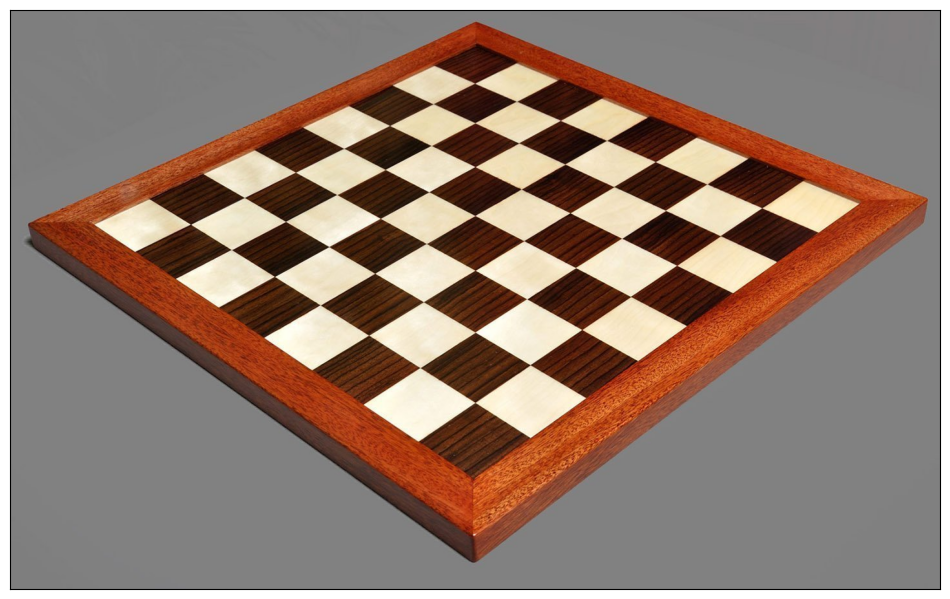

In [ ]:
im = cv2.imread('04-files/chessboard.jpg')
show_img(im, figsize=(12,12));

In [ ]:
gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY).astype(np.float32)

In [ ]:
??cv2.cornerHarris

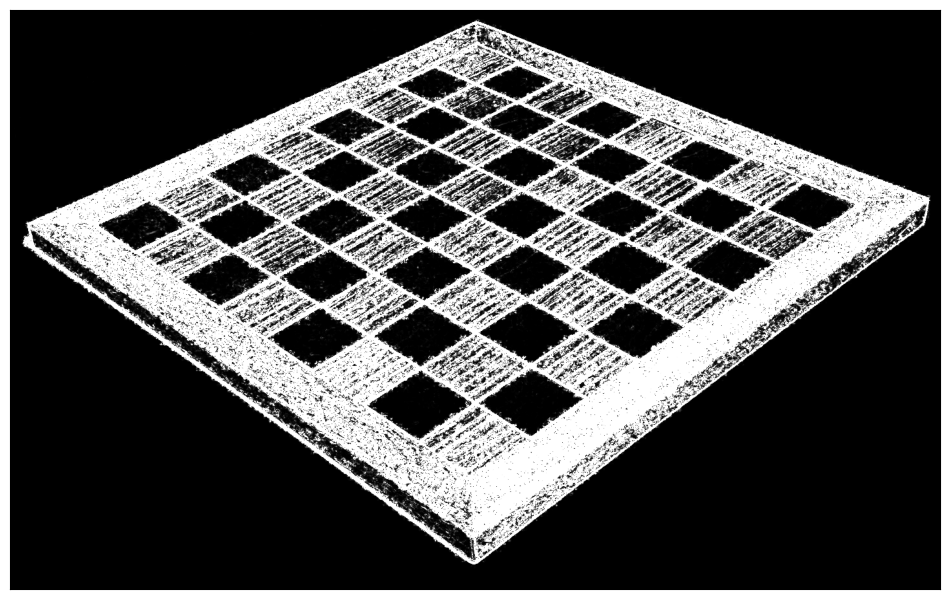

In [ ]:
gray= gray.copy()
dst = cv2.cornerHarris(gray, 2, 3, 0.04)
show_img(cv2.convertScaleAbs(dst), figsize=(12,12));  # the brigter the pixel, the higher the "corner" score

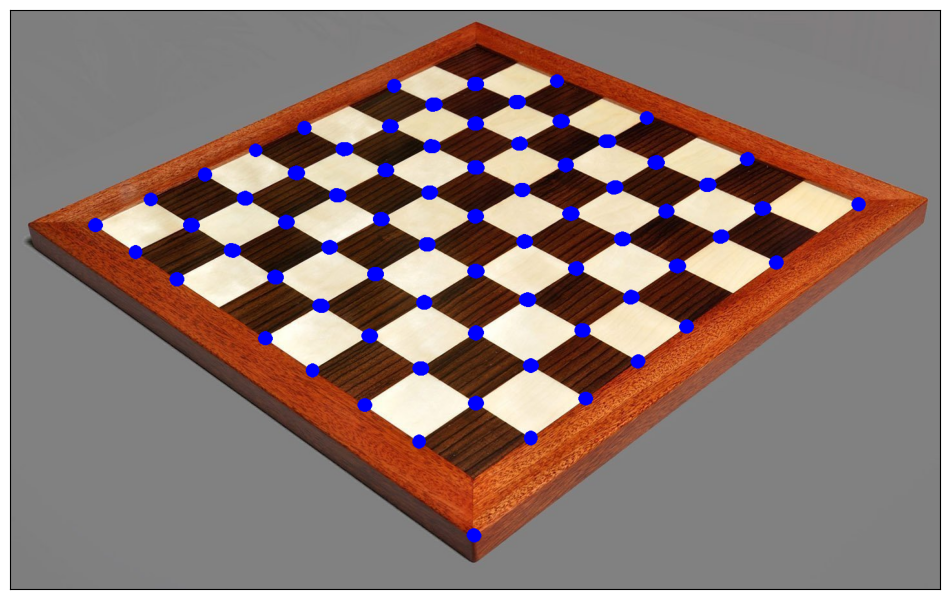

In [ ]:
im_copy = im.copy()
for pt in np.argwhere(dst>0.05*dst.max()):  # keep corners withing 95% of the maximum score
    im_copy = cv2.circle(im_copy, tuple(pt[::-1]), 5, (255,0,0), 10)
show_img(im_copy, figsize=(12,12));

Score distribution (on `log` scale):

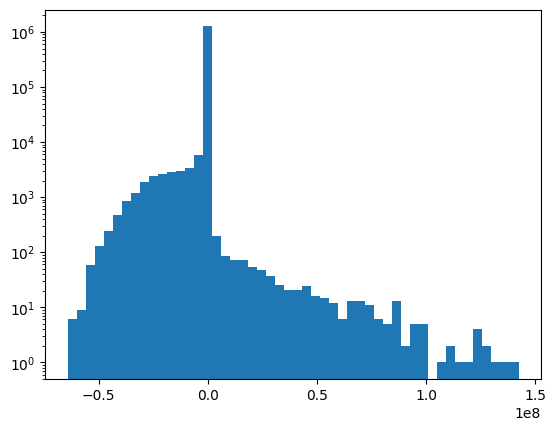

In [ ]:
plt.hist(dst.flatten(), 50, log=True);

### Shi-Tomasi Corner Detection

This is a small modification to Harris detection, with claims* that it performs better.

\* some 95% of scientific progress is *incremental*, new algorithms address certain weaknesses of the old ones, but at the same time can introduce new weaknesses that the original algorithm didn't have!

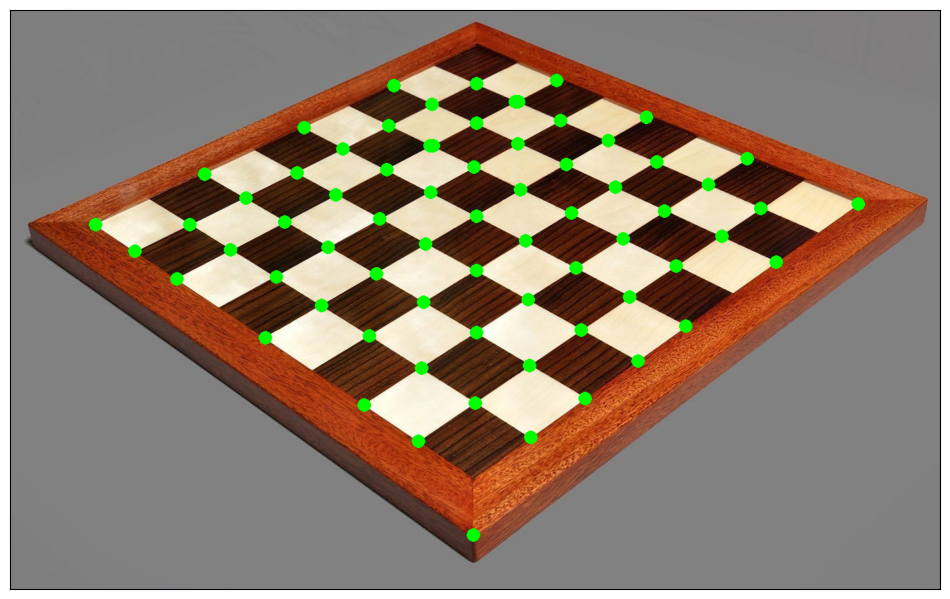

In [ ]:
im_copy = im.copy()
corners = cv2.goodFeaturesToTrack(gray, 70, 0.01, 5, useHarrisDetector=False)  # thresholds the scores for us
for c in corners:
    im_copy = cv2.circle(im_copy, tuple(c.squeeze().astype(int)), 5, (0,255,0), 10)
show_img(im_copy, figsize=(12,12));

## SIFT ~~and SURF~~

After identifying good features we now want to **describe** them using a fixed number of numbers (like e.g. 64 or 128), which is independent of the number of pixels in the feature patch, and will not change much if the feature was rotated, scaled, it's brightness would changed etc.

[SIFT](https://docs.opencv.org/3.4.9/da/df5/tutorial_py_sift_intro.html) (Scale-Invariant Feature Transform) and [SURF](https://docs.opencv.org/3.4.9/df/dd2/tutorial_py_surf_intro.html) (Speeded-Up Robust Features) are two popular descriptor types applicable to many problems. Their biggest limitation is that they are **patented**, so they are not free to use commercially (the SIFT patent actually expired recently).

# Steps in the sift algorithm
1. Scale-space extrema detection:
A key idea in SIFT is to detect features at multiple scales or zoom levels.
This is done by creating blurred versions of the image using the Gaussian function. The algorithm compares different blurred images and finds points of interest i.e features or keypoints that stand out in multiple scales.
2. Keypoint localization:
Next, we refine them to remove unnecessary ones. weak keypoints that are too sensitive to noise are eliminated.
3. Orientation Assignment: Each keypoint is assigned a direction based on the surrounding pixels. This ensures that keypoints can be matched correctly even if the image is rotated.
4. Keypoint Descriptor: Around each keypoint, a small region (16x16 pixels) is taken. This region is divided into smaller parts (4x4), and in each part, we analyze the direction of pixel changes. The result is a 128-value vector that uniquely describes the keypoint.
5. Keypoint Matching: Keypoints from two images are compared to find matching features.

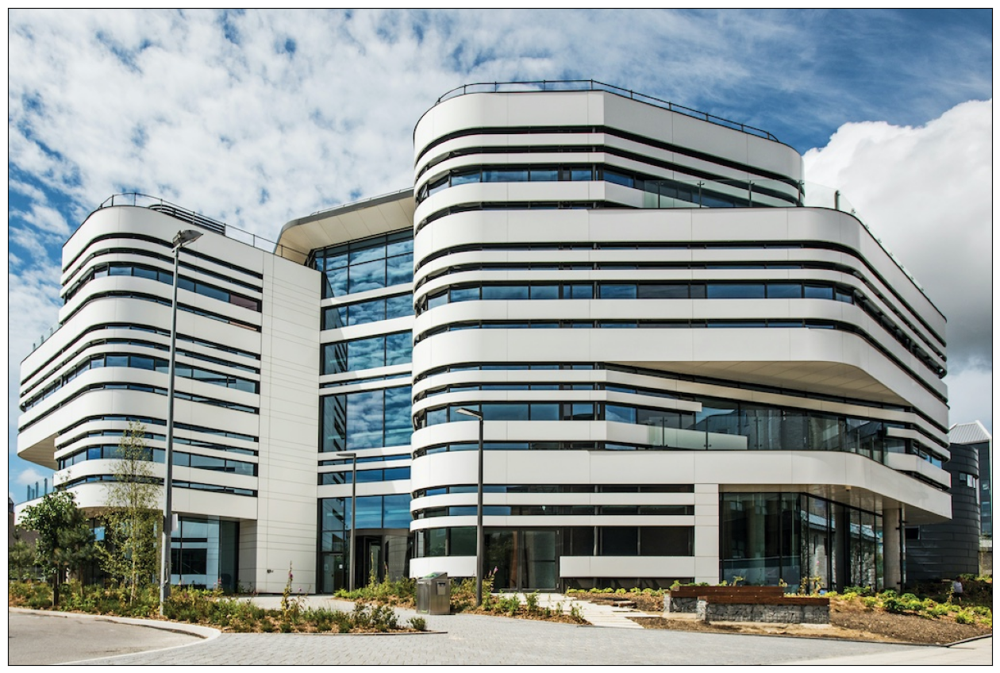

In [ ]:
im = cv2.imread('04-files/fusion-building.jpg')
show_img(im, figsize=(16,16));

In [ ]:
sift = cv2.xfeatures2d.SIFT_create()
kp, des = sift.detectAndCompute(im, None)

# there's also a sift.detect() function - faster, but doesn't give you the descriptors

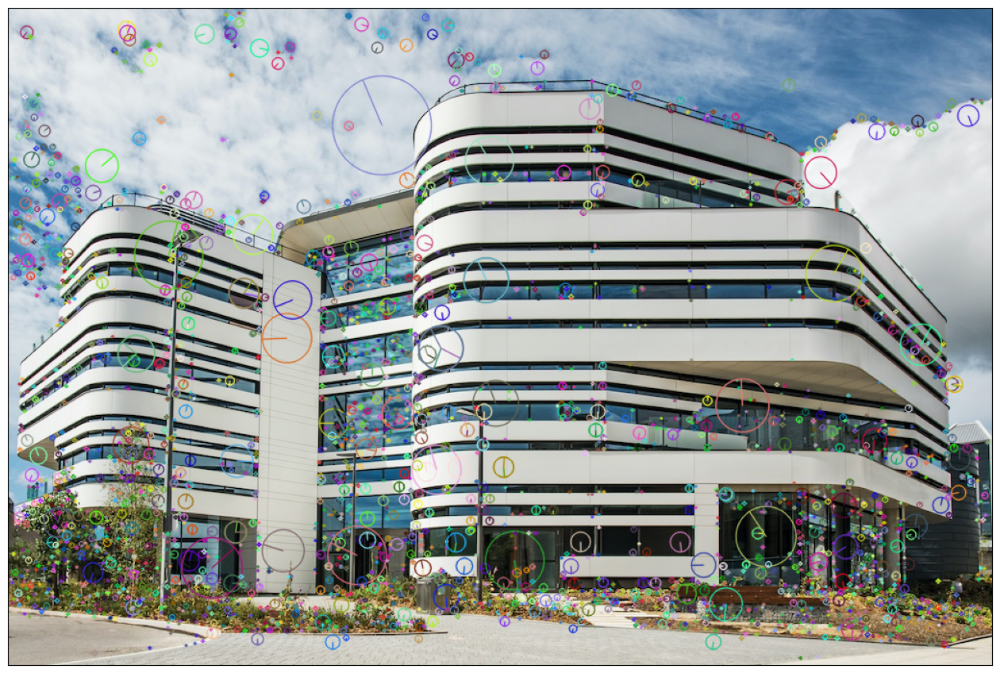

In [ ]:
im_copy = im.copy()
cv2.drawKeypoints(im, kp, im_copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
show_img(im_copy, figsize=(16,16));

In [ ]:
des.shape

(3326, 128)

In [ ]:
# ## SURF has been removed from OpenCV binaries - the following will only work if it's built from source ###
# surf = cv2.xfeatures2d.SURF_create(1324, extended=False) # 1324 gives the almost same number of keypoints as SIFT in this case (for comparison)
# kp, des = surf.detectAndCompute(im, None)
# des.shape

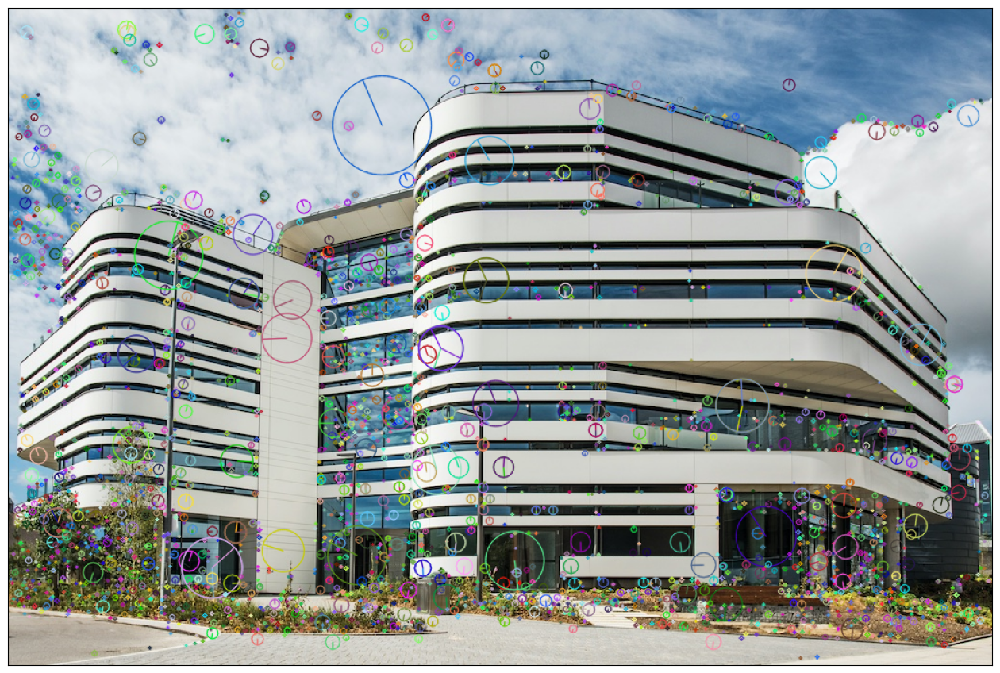

In [ ]:
im_copy = im.copy()
cv2.drawKeypoints(im, kp, im_copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
show_img(im_copy, figsize=(16,16));

Let's see how fast SURF is!

In [ ]:
sift = cv2.xfeatures2d.SIFT_create()
#surf = cv2.xfeatures2d.SURF_create(1324, upright=False, extended=False)

In [ ]:
%timeit -n10 sift.detectAndCompute(im, None)

337 ms ± 35 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [ ]:
#%timeit -n10 surf.detectAndCompute(im, None)

## FAST + BRIEF = ORB

- [FAST](https://docs.opencv.org/3.4.9/df/d0c/tutorial_py_fast.html) (Features from Accelerated Segment Test) is a *corner/keypoint detection* algorithm which is both **fast** (hence the name, important for embedded devices like robotic vacuum cleaners) and **free** (not patented).
- [BRIEF](https://docs.opencv.org/3.4.9/dc/d7d/tutorial_py_brief.html) (Binary Robust Independent Elementary Features) is a *descriptor* calculation algorithm which is much more memory efficient than SIFT and SURF (again, important for embedded devices) and also free.
- [ORB](https://docs.opencv.org/3.4.9/d1/d89/tutorial_py_orb.html) (Oriented FAST and Rotated BRIEF) as a combination of these two with some additional goodies! So fast, small and free!

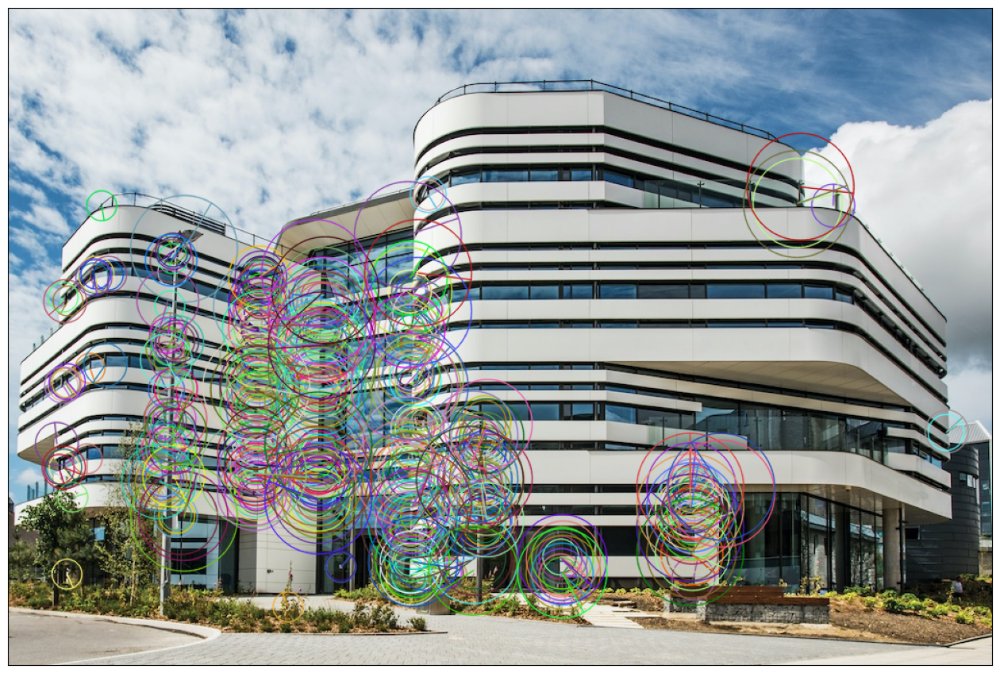

In [ ]:
im = cv2.imread('04-files/fusion-building.jpg')
orb = cv2.ORB_create()
kp = orb.detect(im, None)
kp, des = orb.compute(im, kp)
img2 = cv2.drawKeypoints(im, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
show_img(img2, figsize=(16,16));

In [ ]:
des.shape

(500, 32)

In [ ]:
orb = cv2.ORB_create()
%timeit -n10 orb.compute(im, orb.detect(im, None))

24.2 ms ± 674 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


# Feature matching

Having detected and described a set of features in multiple images, we now want to match them, i.e. work out which features in the first image correspond with features in the second image. Feature matching can then facilitate other tasks like panorama stitching or object detection.

In [ ]:
def show_imgs(ims, rows=1, figsize=(16,8)):
    _,ax = plt.subplots(rows, len(ims)//rows, figsize=figsize)
    [show_img(im,ax_) for im,ax_ in zip(ims,ax.flatten())]
    return ax

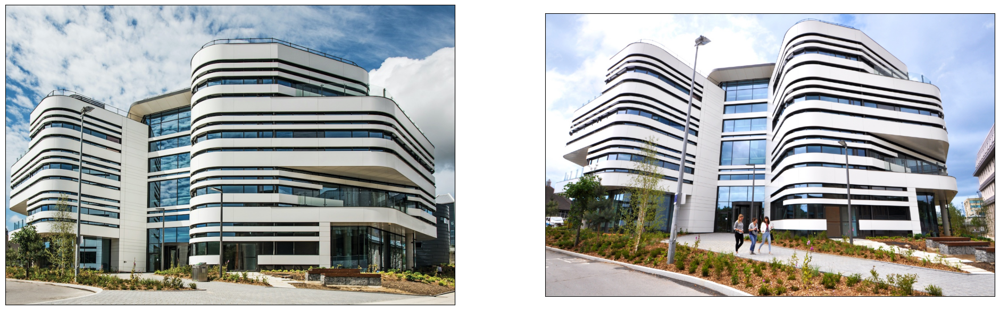

In [ ]:
im1 = cv2.imread('04-files/fusion-building.jpg')
im2 = cv2.imread('04-files/fusion-building2.jpg')
show_imgs((im1,im2), rows=1, figsize=(24,12));

## Brute-force matcher

The [brute-force matcher](https://docs.opencv.org/3.4.9/dc/dc3/tutorial_py_matcher.html) tries to match each and every feature in the first image with each and every features in the second image, which is slow. If the first image has $n_1$ features and the second image has $n_2$ features, the brute-force approach will evaluate $n_1 \times n_2$ potential matches.

In [ ]:
im1=im1.copy()
im2=im2.copy()

#descr = cv2.xfeatures2d.SIFT_create()
descr = cv2.ORB_create()

#kp1,des1 = descr.detectAndCompute(im1,None)
#kp2,des2 = descr.detectAndCompute(im2,None)

kp1, des1 = orb.detectAndCompute(im1,None)
kp2, des2 = orb.detectAndCompute(im2,None)

`cv2.BFMatcher` takes two arguments:
- `normType` - denotes *how* to calculate the similarity of the descriptors; `cv2.NORM_L2` (i.e. Euclidean) is the default, which works well for SIFT and SURF; for ORB `cv2.NORM_HAMMING` (i.e. bit distance)
- `crossCheck` - `False` by default; if `True` only returns matches which are "symmetrical", i.e. where a pair of descriptors are each others best matches

The `cv2.BFMatcher.match(queryDescr, trainDescr)` method returns a `list` of `DMatch` objects:
- `DMatch.distance` - distance between descriptors using `normType`
- `DMatch.queryIdx` - index of the descriptor in query descriptors
- `DMatch.trainIdx` - index of the descriptor in train descriptors

In [ ]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
#bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)
matches = sorted(matches, key=lambda x: x.distance)  # sorting trick

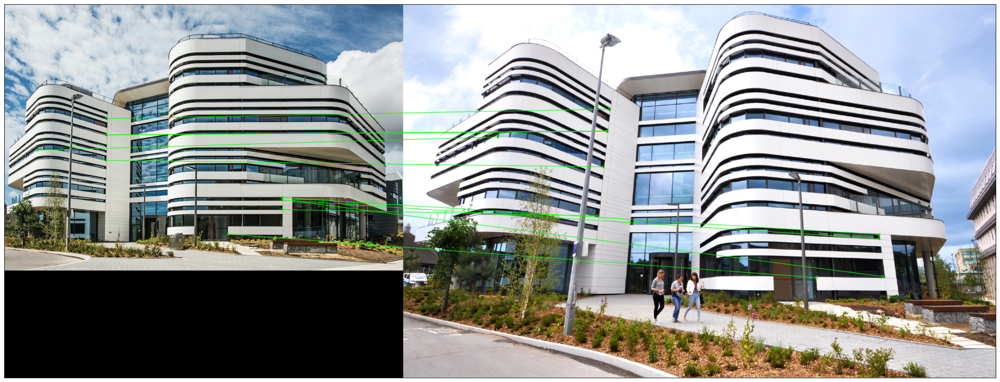

In [ ]:
im_match = cv2.drawMatches(im1,kp1,im2,kp2,matches[:10],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,matchColor=(0,255,0))
show_img(im_match, figsize=(30,30));

## FLANN (Fast Library for Approximate Nearest Neighbors) matching

In [ ]:
im1=im1.copy()
im2=im2.copy()

FLANN_INDEX_KDTREE=1
#FLANN_INDEX_KMEANS = 2

index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params,search_params)

matches = flann.match(des1.astype(np.float32),des2.astype(np.float32))
matches = sorted(matches, key=lambda x: x.distance)

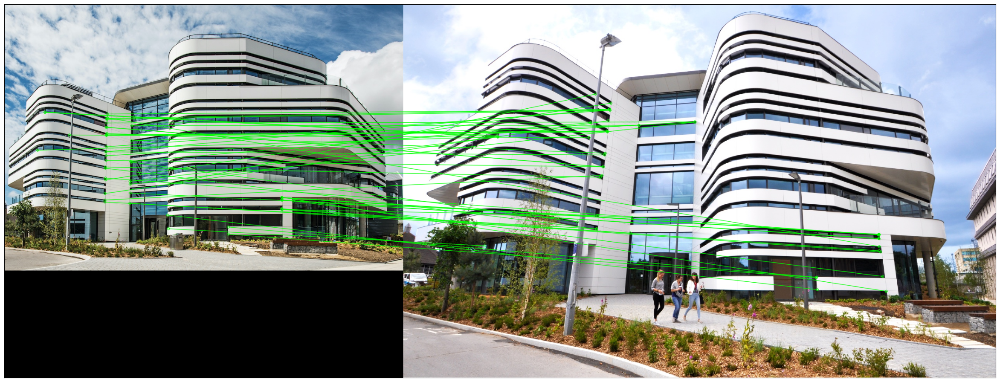

In [ ]:
im_match = cv2.drawMatches(im1,kp1,im2,kp2,matches[:50],None,matchColor=(0,255,0),flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
show_img(im_match, figsize=(30,30));

## Homography

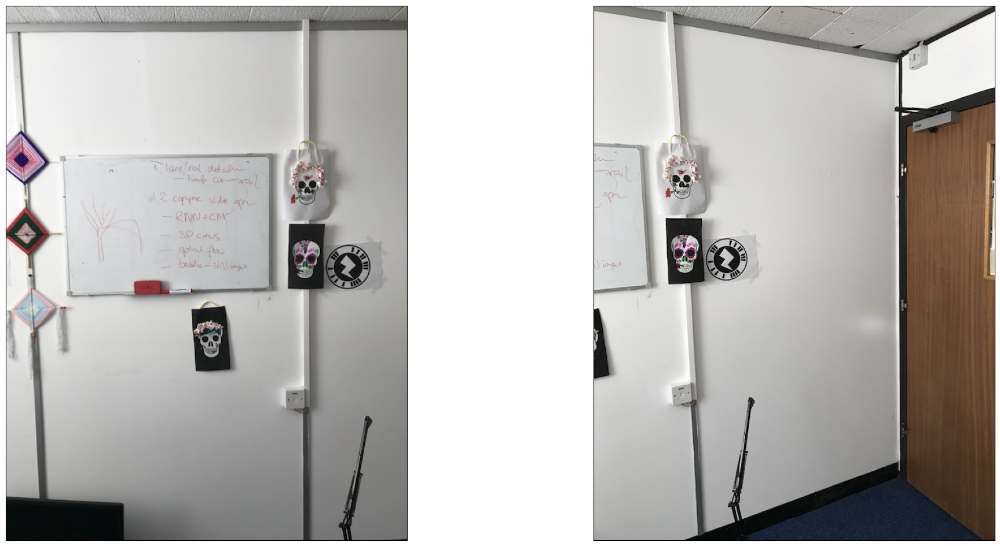

In [ ]:
im1 = cv2.imread('04-files/pano-L.jpg')
im2 = cv2.imread('04-files/pano-R.jpg')
show_imgs((im1,im2), rows=1, figsize=(24,12));

In [ ]:
descr = cv2.xfeatures2d.SIFT_create()
# descr = cv2.ORB_create()
kp1,des1 = descr.detectAndCompute(im1, None)
kp2,des2 = descr.detectAndCompute(im2, None)

In [ ]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
matches = bf.match(des1,des2)
matches = sorted(matches, key=lambda x: x.distance)

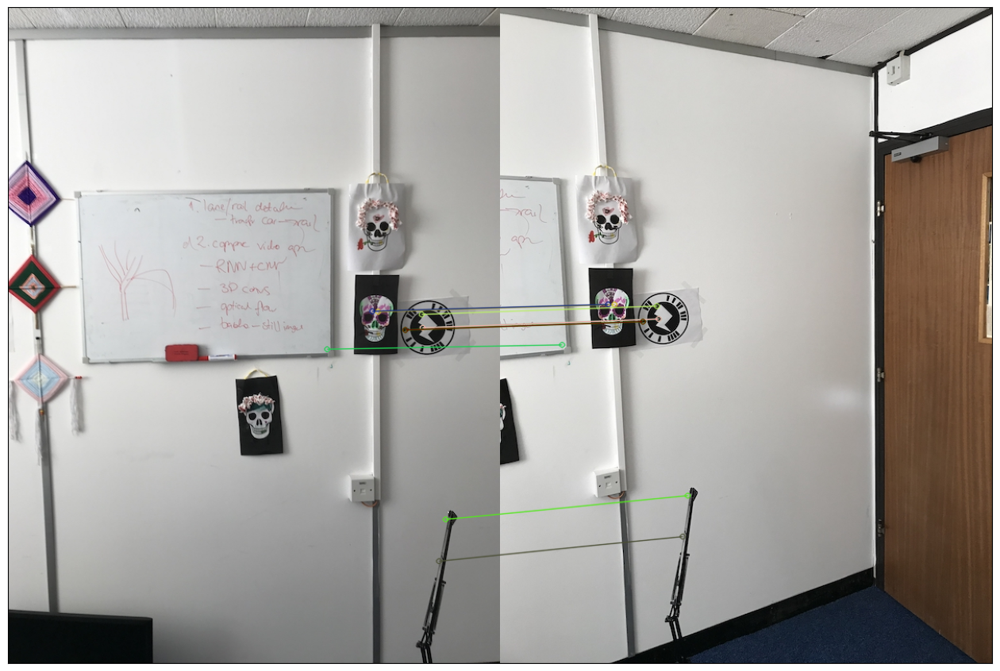

In [ ]:
im_match = cv2.drawMatches(im1,kp1,im2,kp2,matches[:10],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
show_img(im_match, figsize=(16,16));

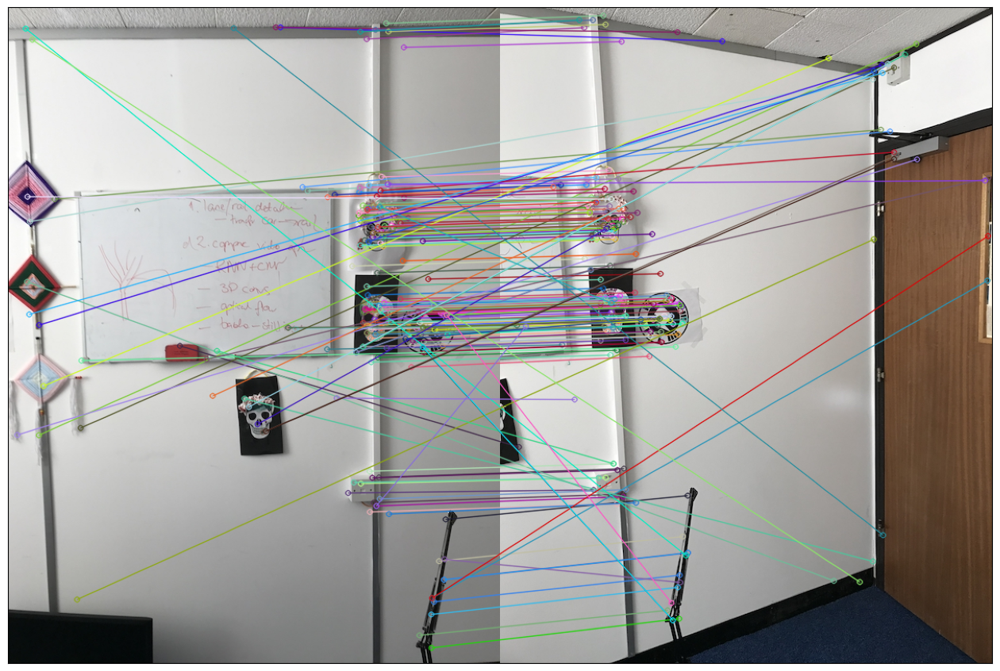

In [ ]:
# let's see all of them
im_match = cv2.drawMatches(im1,kp1,im2,kp2,matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
show_img(im_match, figsize=(16,16));

We will use the [RANSAC (Random Sample Consensus)](https://en.wikipedia.org/wiki/Random_sample_consensus) algorithm to find the transformation matrix based on true matches and ignoring the incorrect ones.

In [ ]:
pts1 = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
pts2 = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
M, mask = cv2.findHomography(pts2, pts1, cv2.RANSAC, 5.0) # RANSAC = Random Sample Consensus

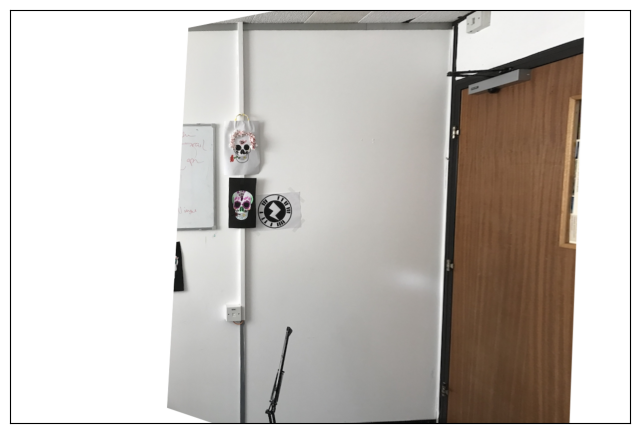

In [ ]:

out = cv2.warpPerspective(im2, M, (im1.shape[1]+im2.shape[1], im1.shape[0]), borderValue=(255,255,255))
show_img(out);

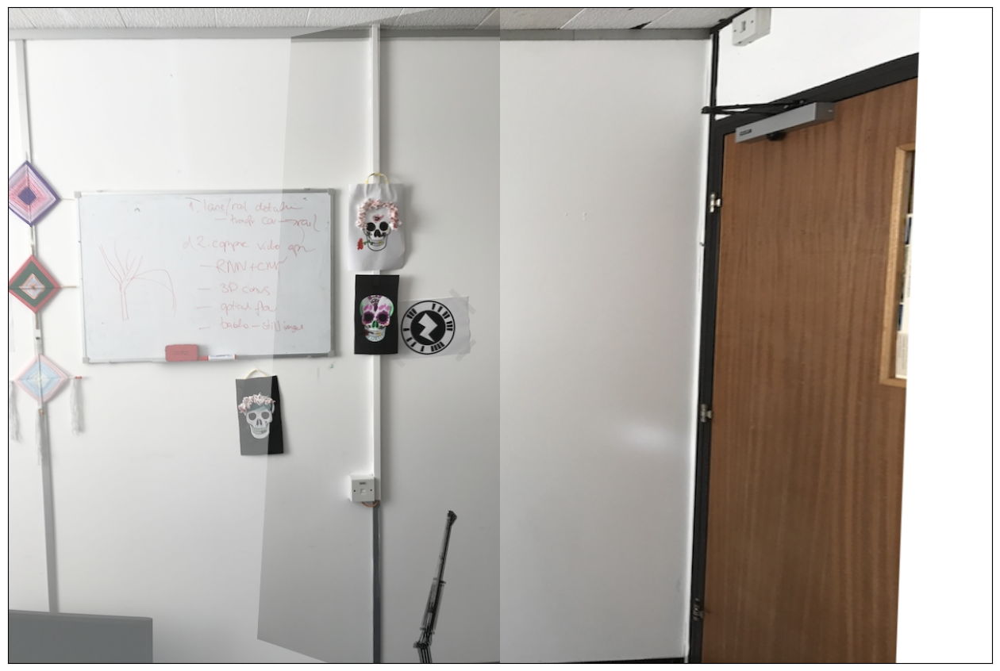

In [ ]:
alpha = 0.6
blended = out.copy()
blended[0:im1.shape[0], 0:im1.shape[1]] = (1-alpha)*out[0:im1.shape[0], 0:im1.shape[1]] + alpha*im1
show_img(blended.astype(np.uint8), figsize=(16,16));

There are some imprefections especially at the edges of the stitched image, where we didn't have any features.

## Panorama stitching in one line of code

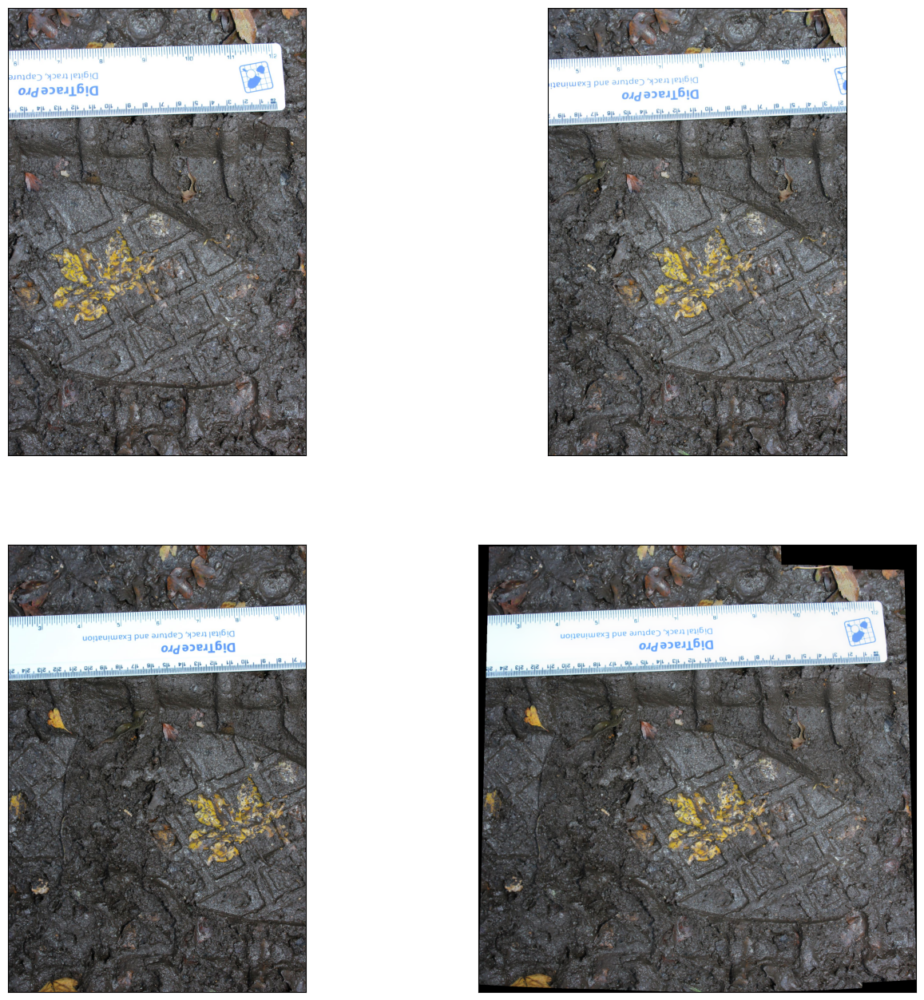

In [ ]:
# Use cv2.Stitcher_create() instead of cv2.createStitcher()
stitcher = cv2.Stitcher_create()
im1 = cv2.imread('04-files/IMG_5781.JPG')
im2 = cv2.imread('04-files/IMG_5782.JPG')
im3 = cv2.imread('04-files/IMG_5783.JPG')

# The stitcher returns a status code and the result image
status, result = stitcher.stitch((im1, im2, im3))

if status == cv2.Stitcher_OK:
    show_imgs((im1, im2, im3, result), rows=2, figsize=(16,16))
else:
    print(f"Stitching failed with status code {status}")

# Optical flow

[Optical flow](https://en.wikipedia.org/wiki/Optical_flow) is the pattern of apparent motion of objects between two consecutive frames of a video sequence caused by the movemement of object or camera. The ball in the image below moves in 5 consecutive frames with the arrow denoting the displacement vector (either the ball or camera is moving or both). Useful for tracking trajectory of objects.

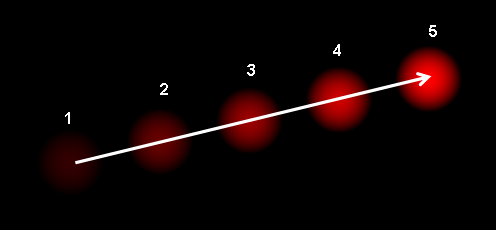![](https://upload.wikimedia.org/wikipedia/en/1/10/Optical_flow_example_v2.png)

## Working with videos

In [ ]:
cap = cv2.VideoCapture('04-files/dashcam.mp4')

frames = []
for i in range(100):
    ret,frame = cap.read()
    frames.append(frame[:,:,::-1])

cap.release()

In [ ]:
import matplotlib.animation as animation

def get_video(frames, interval=50, figsize=(12,8)):

    def animate(i):
        img.set_data(frames[i])
        return (img,)

    fig, ax = plt.subplots(1,1,figsize=figsize)
    img = ax.imshow(frames[0])
    ax.axis('off')
    anim = animation.FuncAnimation(fig, animate, frames=len(frames), interval=interval, blit=True, repeat_delay=5000)
    plt.close()
    return anim.to_html5_video()

In [ ]:
from IPython.core.display import  HTML
HTML(get_video(frames))

## Sparse optical flow (Lucas-Kanade)

In [ ]:
fix_frame = lambda fr: fr[:,:,::-1]

color = np.random.randint(0,255,(100,3))

cap = cv2.VideoCapture('04-files/dashcam.mp4')
ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
p0 = cv2.goodFeaturesToTrack(old_gray, mask=None, maxCorners=100, qualityLevel=0.3, minDistance=7, blockSize=7)

mask = np.zeros_like(old_frame) # for drawing
frames = []
for i in range(100):
    ret,frame = cap.read()
    if not ret: break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    p1,st,_ = cv2.calcOpticalFlowPyrLK(old_gray, gray, p0, None, winSize=(15,15), maxLevel=2, criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

    good_new, good_old = p1[st==1], p0[st==1]

    # draw the tracks
    for i,(new,old) in enumerate(zip(good_new,good_old)):
        a,b = new.ravel().astype(int)
        c,d = old.ravel().astype(int)
        mask = cv2.line(mask, (a,b),(c,d), color[i].tolist(), 2)
        frame = cv2.circle(frame,(a,b),5,color[i].tolist(),-1)
    img = cv2.add(frame,mask)
    frames.append(fix_frame(img))

    old_gray = gray.copy()
    p0 = good_new.reshape(-1,1,2)

cap.release()

In [ ]:
HTML(get_video(frames, interval=200))

## Dense optical flow

Documentation of `cv2.calcOpticalFlowFarneback` can be found [here](https://docs.opencv.org/3.0-beta/modules/video/doc/motion_analysis_and_object_tracking.html#calcopticalflowfarneback).

In [ ]:
cap = cv2.VideoCapture('04-files/people.avi')

ret, frame1 = cap.read()
prv = cv2.cvtColor(frame1,cv2.COLOR_BGR2GRAY)
hsv = np.zeros_like(frame1)
hsv[...,1] = 255

frames = []
for i in range(100):
    ret, frame2 = cap.read()
    nxt = cv2.cvtColor(frame2,cv2.COLOR_BGR2GRAY)
    flow = cv2.calcOpticalFlowFarneback(prv,nxt,None,pyr_scale=0.5,levels=3,winsize=15,iterations=3,poly_n=5,poly_sigma=1.2,flags=0)
    mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])
    hsv[...,0] = ang*180/np.pi/2
    hsv[...,2] = cv2.normalize(mag,None,0,255,cv2.NORM_MINMAX)
    rgb = cv2.cvtColor(hsv,cv2.COLOR_HSV2BGR)
    prv = nxt
    frames.append(np.hstack((cv2.cvtColor(frame2,cv2.COLOR_BGR2RGB), rgb)))

cap.release()

In [ ]:
HTML(get_video(frames, interval=50))

One interesting application of optical flow is liveness detection - see Section 2.4 of [this](https://arxiv.org/pdf/1405.2227.pdf) paper! Robust liveness detection from photographs and videos is a decent project idea!

# Homework

## For volunteers

Prepare a notebook comparing SIFT and ORB algorithms in the context of descriptor matching. You have already seen that each of these approaches tends to identify different keypoints. Is any of them better than the others for a particular type of image (e.g. outdoor scenes)? Try mixing them up too - for example, what would happen if you used SIFT keypoints with ORB descriptors?